In [2]:
import os
import zipfile
import random
import shutil
import tensorflow as tf
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from shutil import copyfile
import matplotlib.pyplot as plt
import glob
import cv2

In [3]:
def split_data(SOURCE_DIR, TRAINING_DIR, VALIDATION_DIR, SPLIT_SIZE):

  shuffled_source = random.sample(os.listdir(SOURCE_DIR), len(os.listdir(SOURCE_DIR)))

  # Find total number of files in training dir
  training_number = int(len(shuffled_source) * SPLIT_SIZE)

  i = 0
  target = TRAINING_DIR

  for item in shuffled_source:
    item_source = os.path.join(SOURCE_DIR, item)
    if os.path.getsize(item_source) == 0:
      print(f'{item} is zero length, so ignoring.')
    else: 
      copyfile(item_source, os.path.join(target, item))
      i += 1

    # Switch copy target to TESTING
    if i == training_number:
      target = VALIDATION_DIR

In [6]:
# create directory

label = ['Banana_Bad', 'Orange_Bad', 'Banana_Good', 'Orange_Good']

root_path = './'

# for i in ['train', 'test']:
#     os.makedirs(os.path.join(f'{root_path}', i))
#     for j in label:
#         os.makedirs(os.path.join(f'{root_path}' + i, j))


# simpler code
for i in ['train', 'test', 'validation']:
    os.makedirs(f'./{i}')
    for j in label:
        os.makedirs(f'./{i}/{j}')

In [ ]:
split_size = .8

for i in label:
    # split_data('./dataset-sampah/' + i, './train/' + i, './test/' + i, split_size)

    # again, simpler code
    split_data(f'./dataset/{i}', f'./train/{i}', f'./test/{i}', split_size)

In [7]:
from shutil import copy2
from sklearn.model_selection import train_test_split

label = ['Banana_Bad', 'Orange_Bad', 'Banana_Good', 'Orange_Good']
root_path = './'

# Create directories for train, test, and validation datasets
for i in ['train', 'test', 'validation']:
    os.makedirs(f'./{i}', exist_ok=True)
    for j in label:
        os.makedirs(f'./{i}/{j}', exist_ok=True)

split_size_train = 0.8

def split_data(source_dir, train_dir, test_dir, val_dir, split_size_train):
    all_files = os.listdir(source_dir)
    train_files, temp_files = train_test_split(all_files, train_size=split_size_train)
    test_files, val_files = train_test_split(temp_files, test_size=0.5)  # Split remaining 20% into 10% test and 10% validation
    
    for file in train_files:
        copy2(os.path.join(source_dir, file), train_dir)
    for file in test_files:
        copy2(os.path.join(source_dir, file), test_dir)
    for file in val_files:
        copy2(os.path.join(source_dir, file), val_dir)

# Split the data into train, test, and validation sets
for i in label:
    source_dir = f'./dataset/{i}'
    train_dir = f'./train/{i}'
    test_dir = f'./test/{i}'
    val_dir = f'./validation/{i}'
    split_data(source_dir, train_dir, test_dir, val_dir, split_size_train)

In [5]:
def count_images_in_folder(folder_path):
    count = 0
    for root, dirs, files in os.walk(folder_path):
        count += len(files)
    return count

# Definisikan path untuk train, test, dan validation
train_path = './train'
test_path = './test'
validation_path = './validation'

# Hitung jumlah citra di masing-masing folder
train_count = {label: count_images_in_folder(os.path.join(train_path, label)) for label in label}
test_count = {label: count_images_in_folder(os.path.join(test_path, label)) for label in label}
validation_count = {label: count_images_in_folder(os.path.join(validation_path, label)) for label in label}

# Tampilkan jumlah citra di masing-masing folder
print("Jumlah citra di folder train:")
for label, count in train_count.items():
    print(f"{label}: {count}")

print("\nJumlah citra di folder test:")
for label, count in test_count.items():
    print(f"{label}: {count}")

print("\nJumlah citra di folder validation:")
for label, count in validation_count.items():
    print(f"{label}: {count}")

Jumlah citra di folder train:
Banana_Bad: 800
Orange_Bad: 800
Banana_Good: 800
Orange_Good: 800

Jumlah citra di folder test:
Banana_Bad: 100
Orange_Bad: 100
Banana_Good: 100
Orange_Good: 100

Jumlah citra di folder validation:
Banana_Bad: 100
Orange_Bad: 100
Banana_Good: 100
Orange_Good: 100


In [8]:
from tensorflow.keras.preprocessing.image import ImageDataGenerator

def create_generators(TRAINING_DIR, VALIDATION_DIR, TEST_DIR):

    # Instantiate the ImageDataGenerator class for training data (with augmentation)
    train_datagen = ImageDataGenerator(rescale=1./255.,
                                       rotation_range=40,
                                       width_shift_range=0.2,
                                       height_shift_range=0.2,
                                       shear_range=0.2,
                                       zoom_range=0.2,
                                       horizontal_flip=True,
                                       fill_mode='nearest')

    # Pass in the appropriate arguments to the flow_from_directory method
    train_generator = train_datagen.flow_from_directory(directory=TRAINING_DIR,
                                                        batch_size=8,
                                                        class_mode='binary',  
                                                        target_size=(150, 150)
                                                        ,shuffle = True
                                                        )

    # Instantiate the ImageDataGenerator class for validation data (only rescaling)
    validation_datagen = ImageDataGenerator(rescale=1./255.)

    # Pass in the appropriate arguments to the flow_from_directory method
    validation_generator = validation_datagen.flow_from_directory(directory=VALIDATION_DIR,
                                                                  batch_size=8,
                                                                  class_mode='binary',  
                                                                  target_size=(150, 150),
                                                                  shuffle = False)

    # Instantiate the ImageDataGenerator class for test data (only rescaling)
    test_datagen = ImageDataGenerator(rescale=1./255.)

    # Pass in the appropriate arguments to the flow_from_directory method
    test_generator = test_datagen.flow_from_directory(directory=TEST_DIR,
                                                      batch_size=8,
                                                      class_mode='binary',  
                                                      target_size=(150, 150),
                                                      shuffle = False
                                                      )

    return train_generator, validation_generator, test_generator

# Define directories
TRAINING_DIR = './train/'
VALIDATION_DIR = './validation/'
TEST_DIR = './test/'

# Get the generators
train_generator, validation_generator, test_generator = create_generators(TRAINING_DIR, VALIDATION_DIR, TEST_DIR)

# Print the number of images in each set
print(f"Total training images: {train_generator.samples}")
print(f"Total validation images: {validation_generator.samples}")
print(f"Total test images: {test_generator.samples}")


Found 3200 images belonging to 4 classes.
Found 400 images belonging to 4 classes.
Found 400 images belonging to 4 classes.
Total training images: 3200
Total validation images: 400
Total test images: 400


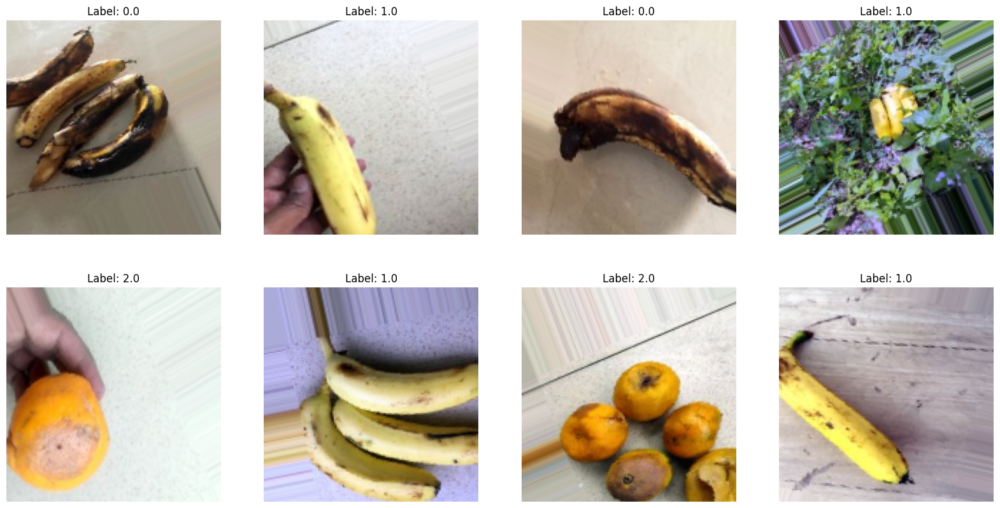

In [9]:
images, labels = next(train_generator)

# Display the images
plt.figure(figsize=(20, 10))
for i in range(len(images)):
    plt.subplot(2, 4, i + 1)
    plt.imshow(images[i])
    plt.title(f'Label: {labels[i]}')
    plt.axis('off')
plt.show()

In [10]:
model = tf.keras.models.Sequential([
    tf.keras.layers.Conv2D(150, (3, 3), activation='relu', input_shape=(150, 150, 3)),
    tf.keras.layers.MaxPooling2D(2, 2),
    tf.keras.layers.Conv2D(75, (3, 3), activation='relu'),
    tf.keras.layers.MaxPooling2D(2, 2),
    # Flatten
    tf.keras.layers.Flatten(),
    tf.keras.layers.Dropout(0.5),
    tf.keras.layers.Dense(256, activation='relu'),
    tf.keras.layers.Dense(128, activation='relu'),
    tf.keras.layers.Dense(64, activation='relu'),
    # __ classes
    tf.keras.layers.Dense(4, activation='softmax')
])

model.compile(optimizer=tf.optimizers.Adam(), loss='sparse_categorical_crossentropy', metrics=['accuracy'])
model.summary()

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d (Conv2D)             (None, 148, 148, 150)     4200      
                                                                 
 max_pooling2d (MaxPooling2D  (None, 74, 74, 150)      0         
 )                                                               
                                                                 
 conv2d_1 (Conv2D)           (None, 72, 72, 75)        101325    
                                                                 
 max_pooling2d_1 (MaxPooling  (None, 36, 36, 75)       0         
 2D)                                                             
                                                                 
 flatten (Flatten)           (None, 97200)             0         
                                                                 
 dropout (Dropout)           (None, 97200)             0

In [11]:
history = model.fit(train_generator,
                    epochs=20,
                    batch_size=32,
                    validation_data=validation_generator
                    )

Epoch 1/20
400/400 [==============================] - 32s 66ms/step - loss: 1.3216 - accuracy: 0.3400 - val_loss: 1.0266 - val_accuracy: 0.5325
Epoch 2/20
400/400 [==============================] - 11s 28ms/step - loss: 0.9917 - accuracy: 0.5256 - val_loss: 0.8961 - val_accuracy: 0.6500
Epoch 3/20
400/400 [==============================] - 11s 28ms/step - loss: 0.7261 - accuracy: 0.6906 - val_loss: 0.5004 - val_accuracy: 0.8450
Epoch 4/20
400/400 [==============================] - 11s 28ms/step - loss: 0.5434 - accuracy: 0.7916 - val_loss: 0.3061 - val_accuracy: 0.9050
Epoch 5/20
400/400 [==============================] - 11s 28ms/step - loss: 0.4841 - accuracy: 0.8231 - val_loss: 0.3105 - val_accuracy: 0.8775
Epoch 6/20
400/400 [==============================] - 11s 28ms/step - loss: 0.3652 - accuracy: 0.8669 - val_loss: 0.2483 - val_accuracy: 0.9000
Epoch 7/20
400/400 [==============================] - 11s 29ms/step - loss: 0.3240 - accuracy: 0.8769 - val_loss: 0.2540 - val_accuracy:

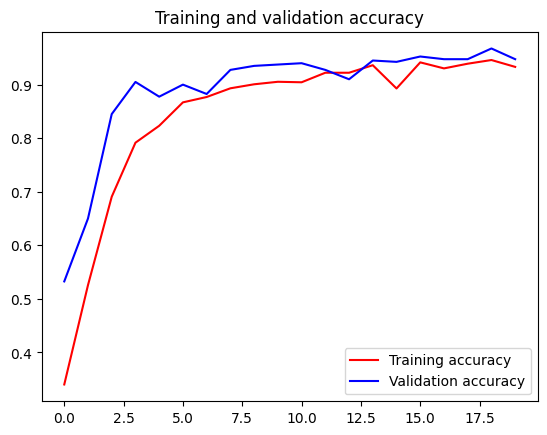

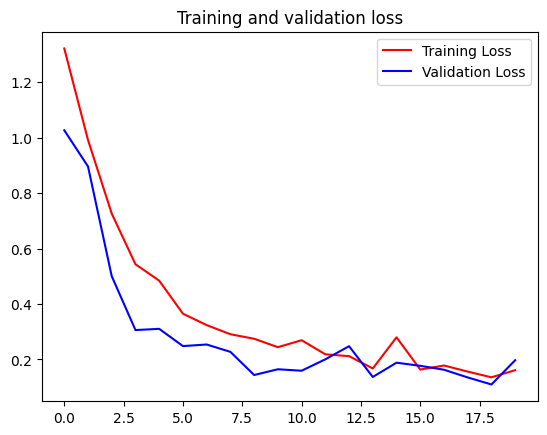

In [12]:
acc = history.history['accuracy']
val_acc = history.history['val_accuracy']
loss = history.history['loss']
val_loss = history.history['val_loss']

epochs = range(len(acc))

plt.plot(epochs, acc, 'r', label='Training accuracy')
plt.plot(epochs, val_acc, 'b', label='Validation accuracy')
plt.title('Training and validation accuracy')
plt.legend()
plt.figure()

plt.plot(epochs, loss, 'r', label='Training Loss')
plt.plot(epochs, val_loss, 'b', label='Validation Loss')
plt.title('Training and validation loss')
plt.legend()

plt.show()

C:\Users\Acer\AppData\Local\Temp\ipykernel_16920\1788485867.py:3: UserWarning: `Model.predict_generator` is deprecated and will be removed in a future version. Please use `Model.predict`, which supports generators.
  Y_pred = model.predict_generator(test_generator)
C:\Users\Acer\AppData\Local\Temp\ipykernel_16920\1788485867.py:17: UserWarning: `Model.predict_generator` is deprecated and will be removed in a future version. Please use `Model.predict`, which supports generators.
  Y_pred = model.predict_generator(test_generator)


Classification Report
              precision    recall  f1-score   support

  Banana_Bad       0.97      1.00      0.99       100
 Banana_Good       0.99      0.98      0.98       100
  Orange_Bad       0.97      0.87      0.92       100
 Orange_Good       0.90      0.97      0.93       100

    accuracy                           0.95       400
   macro avg       0.96      0.96      0.95       400
weighted avg       0.96      0.95      0.95       400



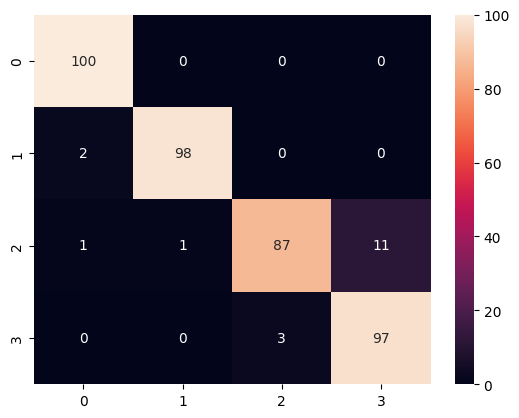

In [13]:
import numpy as np

Y_pred = model.predict_generator(test_generator)
y_pred = np.argmax(Y_pred, axis=1)
y_true = test_generator.classes

# Confusion Matrix
from sklearn.metrics import confusion_matrix
import seaborn as sns
import matplotlib.pyplot as plt

# Some reports
from sklearn.metrics import classification_report, confusion_matrix
import numpy as np

#On test dataset
Y_pred = model.predict_generator(test_generator)
y_pred = np.argmax(Y_pred, axis=1)
classes = list(train_generator.class_indices.keys())
target_names = classes

#Classification Report
print('Classification Report')
print(classification_report(test_generator.classes, y_pred, target_names=target_names))

cm = confusion_matrix(test_generator.classes, y_pred)
sns.heatmap(cm, annot=True, fmt='d')
plt.show()

50/50 [==============================] - 11s 220ms/step
Classification Report
              precision    recall  f1-score   support

  Banana_Bad       0.96      0.99      0.98       100
 Banana_Good       0.94      0.97      0.96       100
  Orange_Bad       0.98      0.86      0.91       100
 Orange_Good       0.92      0.97      0.94       100

    accuracy                           0.95       400
   macro avg       0.95      0.95      0.95       400
weighted avg       0.95      0.95      0.95       400



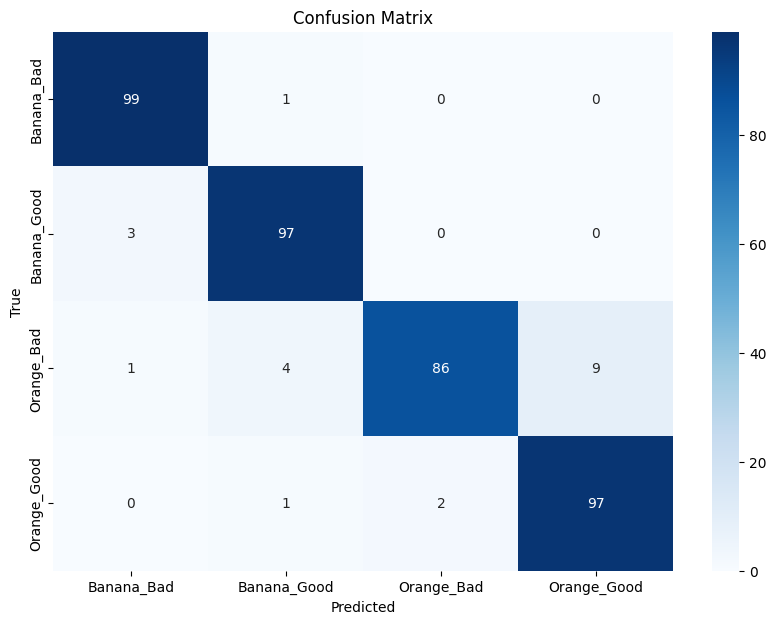

In [15]:
# Memprediksi kelas dari data validasi
Y_pred = model.predict(validation_generator)
y_pred = np.argmax(Y_pred, axis=1)
y_true = validation_generator.classes

print('Classification Report')
print(classification_report(test_generator.classes, y_pred, target_names=target_names))
# Membuat confusion matrix
cm = confusion_matrix(y_true, y_pred)

# Membuat label kelas dari indeks kelas
class_indices = validation_generator.class_indices
class_labels = {v: k for k, v in class_indices.items()}

# Menampilkan confusion matrix dengan label kelas yang sesuai
plt.figure(figsize=(10, 7))
sns.heatmap(cm, annot=True, fmt='d', cmap='Blues', 
            xticklabels=[class_labels[i] for i in range(len(class_labels))], 
            yticklabels=[class_labels[i] for i in range(len(class_labels))])
plt.xlabel('Predicted')
plt.ylabel('True')
plt.title('Confusion Matrix')
plt.show()

1/1 [==============================] - 10s 10s/step


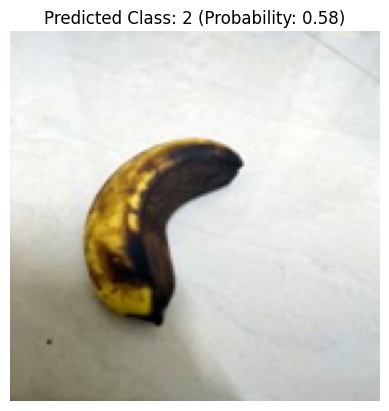

1/1 [==============================] - 0s 14ms/step


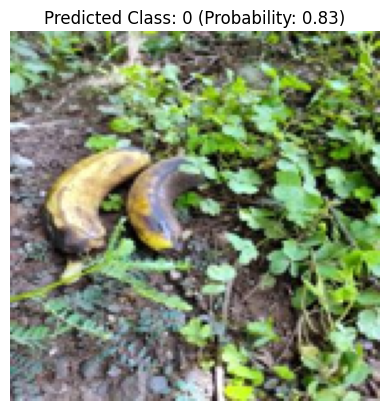

1/1 [==============================] - 0s 13ms/step


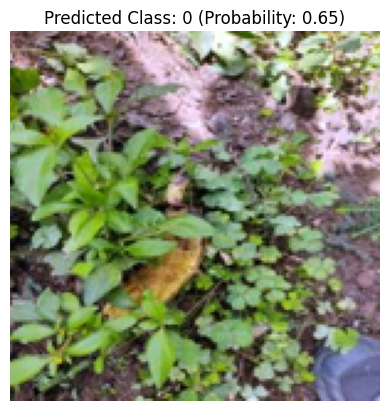

1/1 [==============================] - 0s 30ms/step


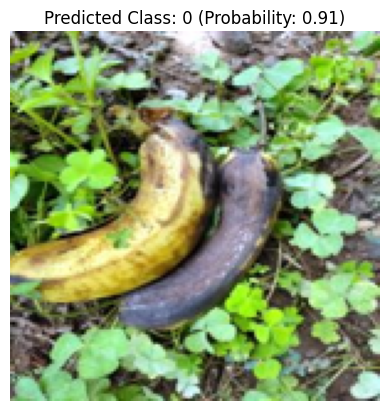

1/1 [==============================] - 0s 19ms/step


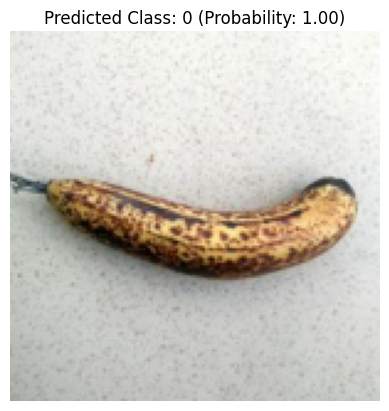

1/1 [==============================] - 0s 15ms/step


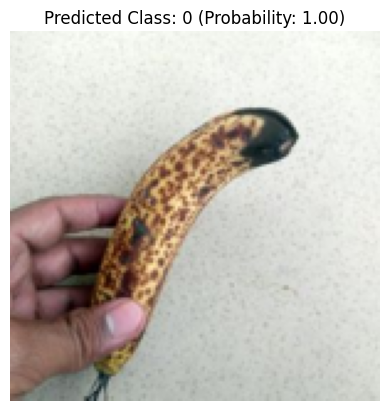

1/1 [==============================] - 0s 13ms/step


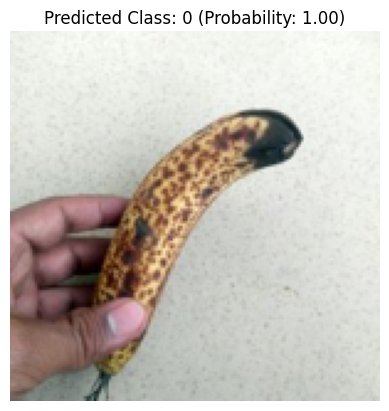

1/1 [==============================] - 0s 14ms/step


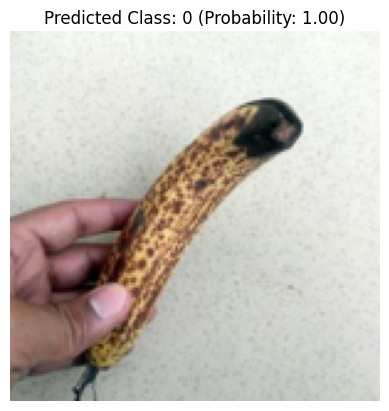

1/1 [==============================] - 0s 14ms/step


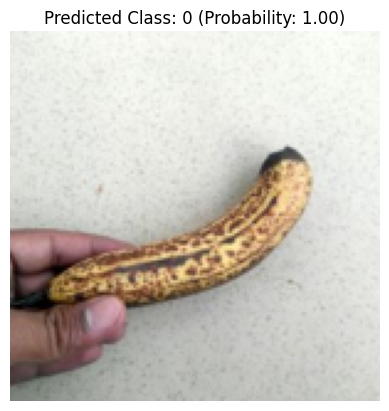

1/1 [==============================] - 0s 14ms/step


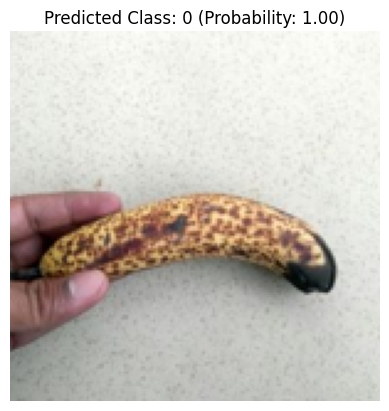

1/1 [==============================] - 0s 18ms/step


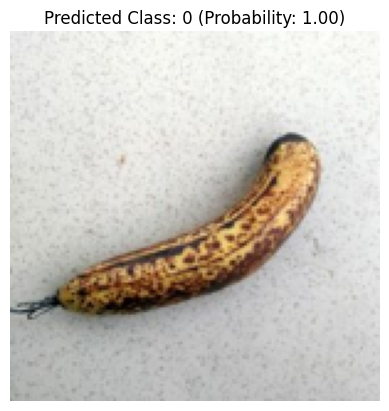

1/1 [==============================] - 0s 15ms/step


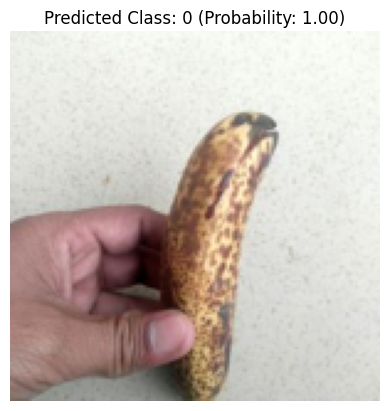

1/1 [==============================] - 0s 18ms/step


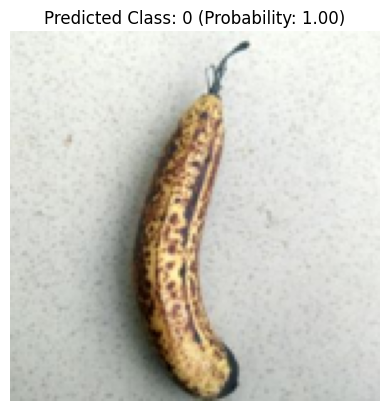

1/1 [==============================] - 0s 13ms/step


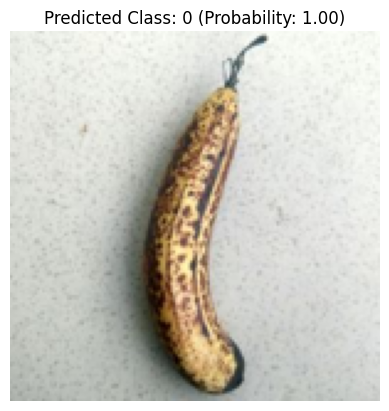

1/1 [==============================] - 0s 14ms/step


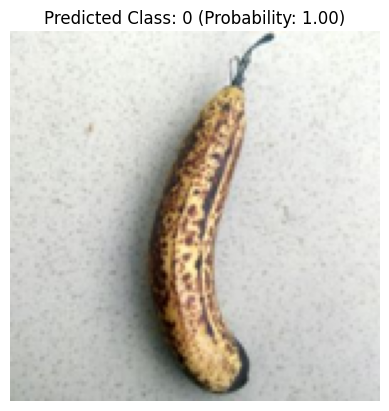

1/1 [==============================] - 0s 14ms/step


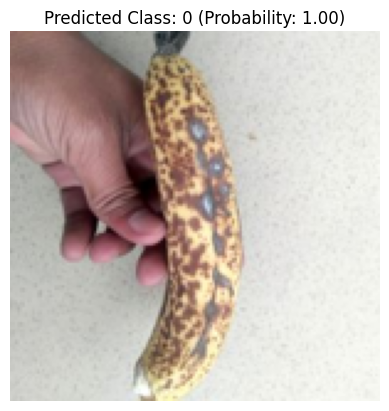

1/1 [==============================] - 0s 13ms/step


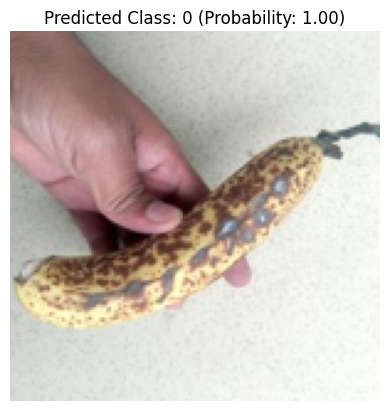

1/1 [==============================] - 0s 12ms/step


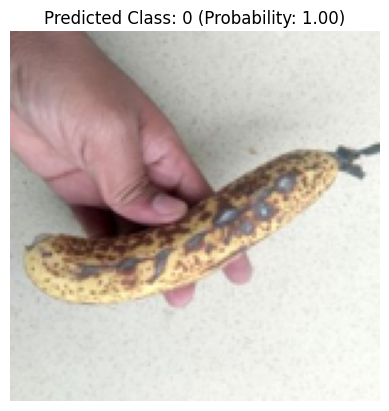

1/1 [==============================] - 0s 15ms/step


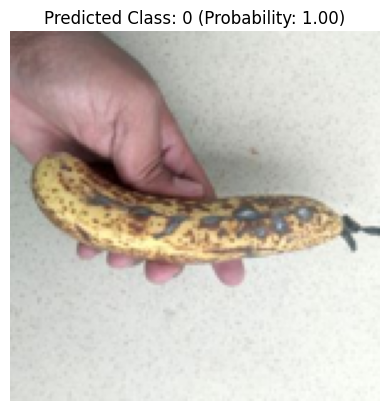

1/1 [==============================] - 0s 20ms/step


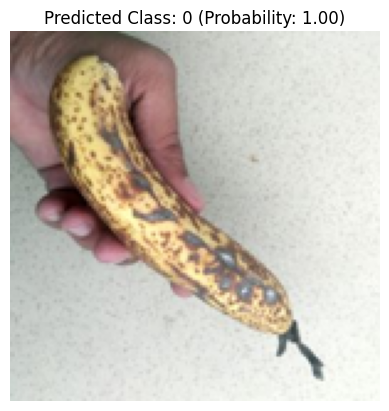

1/1 [==============================] - 0s 17ms/step


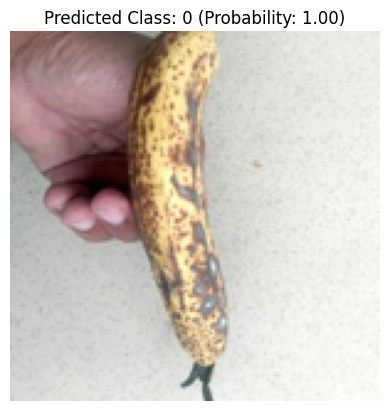

1/1 [==============================] - 0s 15ms/step


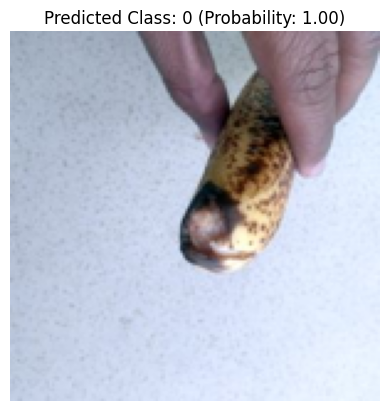

1/1 [==============================] - 0s 16ms/step


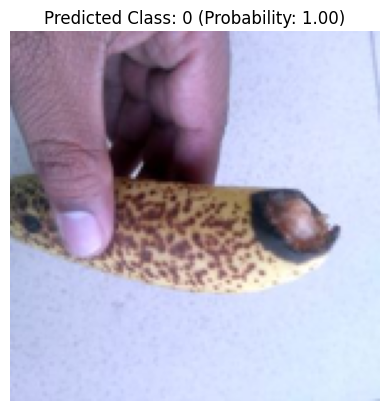

1/1 [==============================] - 0s 13ms/step


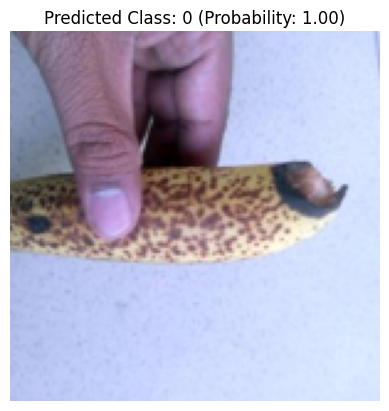

1/1 [==============================] - 0s 13ms/step


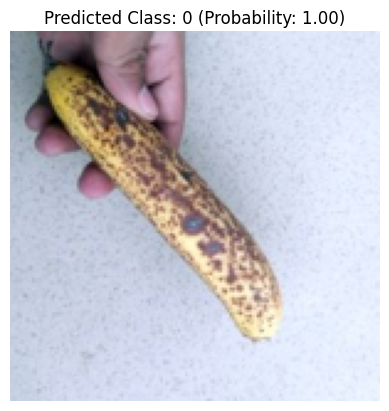

1/1 [==============================] - 0s 18ms/step


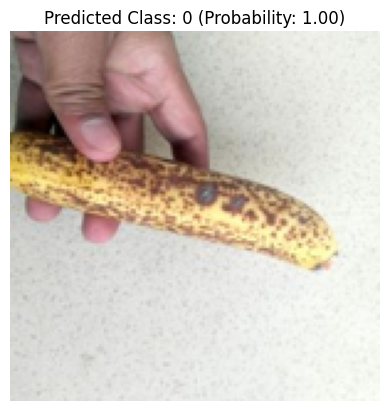

1/1 [==============================] - 0s 14ms/step


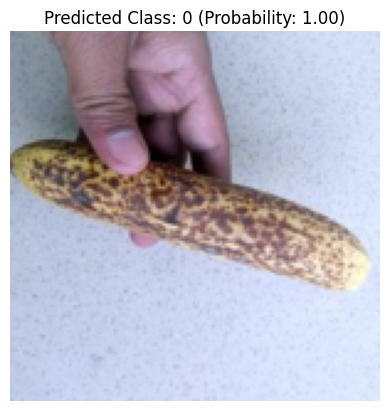

1/1 [==============================] - 0s 15ms/step


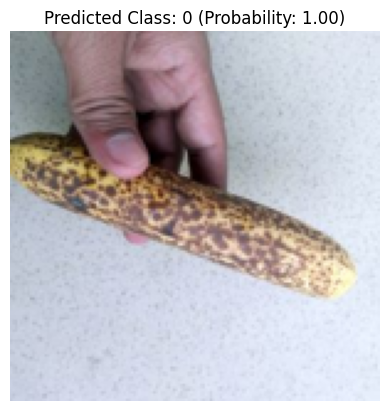

1/1 [==============================] - 0s 15ms/step


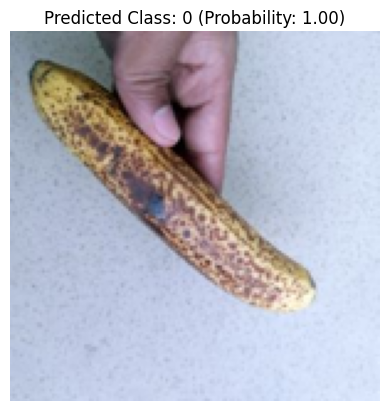

1/1 [==============================] - 0s 15ms/step


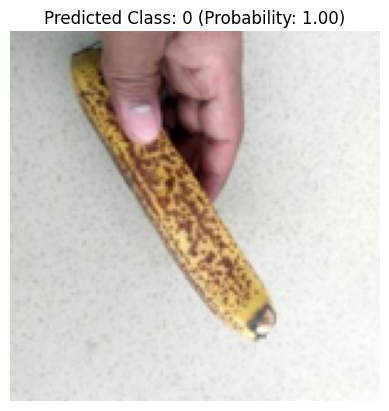

1/1 [==============================] - 0s 26ms/step


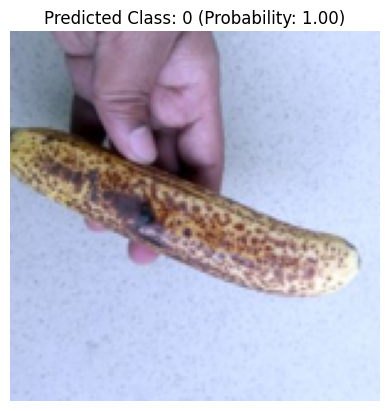

1/1 [==============================] - 0s 15ms/step


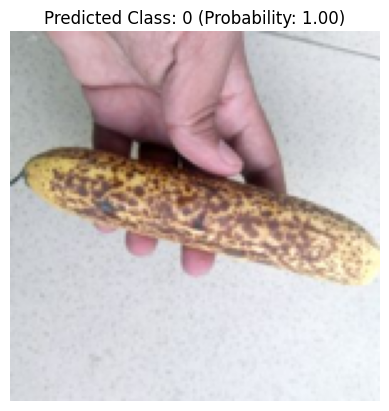

1/1 [==============================] - 0s 21ms/step


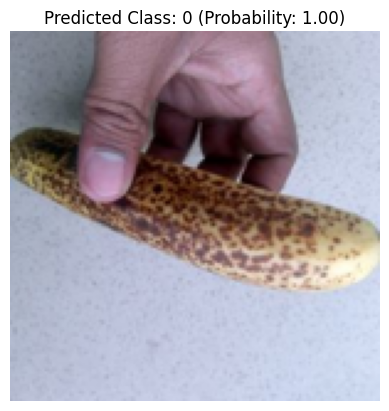

1/1 [==============================] - 0s 16ms/step


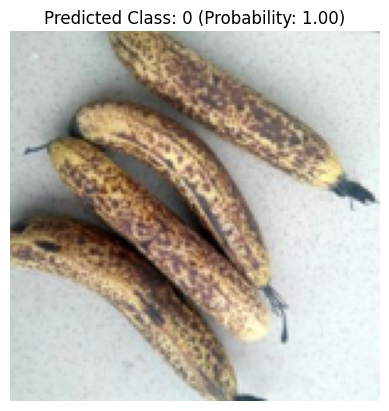

1/1 [==============================] - 0s 15ms/step


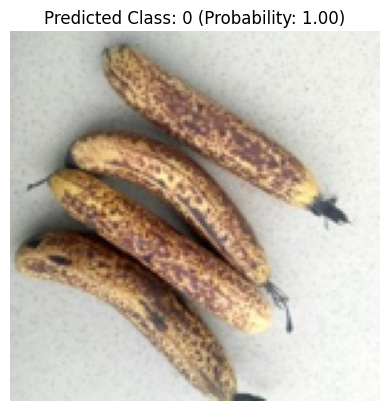

1/1 [==============================] - 0s 16ms/step


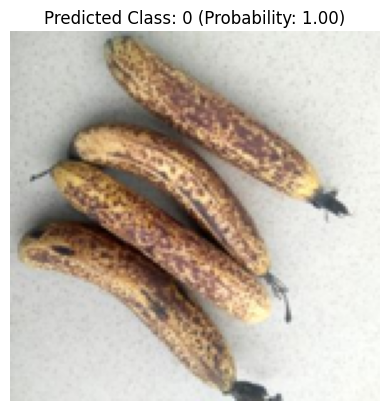

1/1 [==============================] - 0s 14ms/step


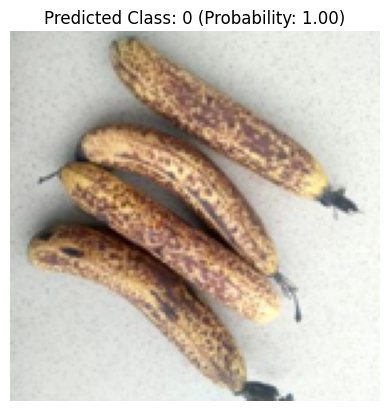

1/1 [==============================] - 0s 15ms/step


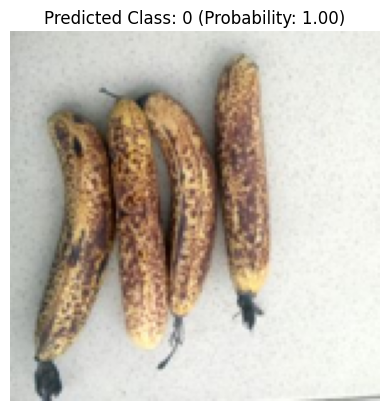

1/1 [==============================] - 0s 13ms/step


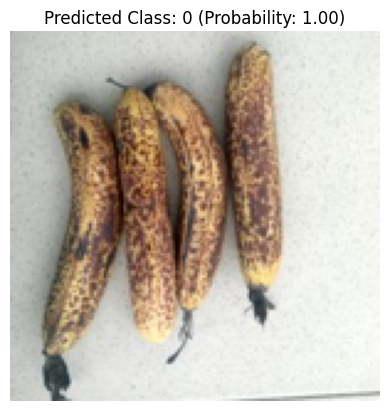

1/1 [==============================] - 0s 201ms/step


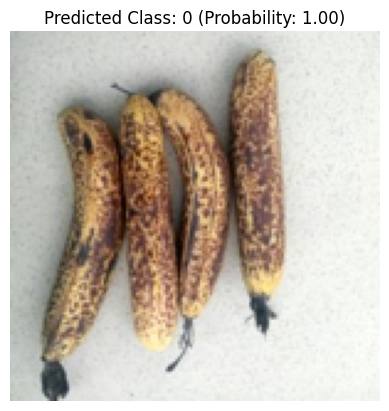

1/1 [==============================] - 0s 14ms/step


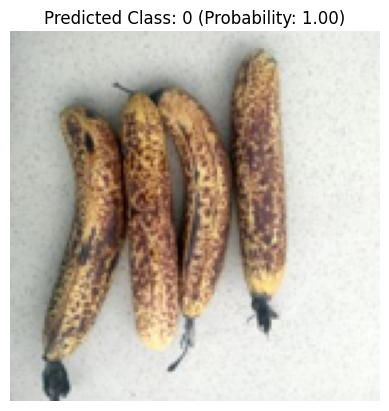

1/1 [==============================] - 0s 14ms/step


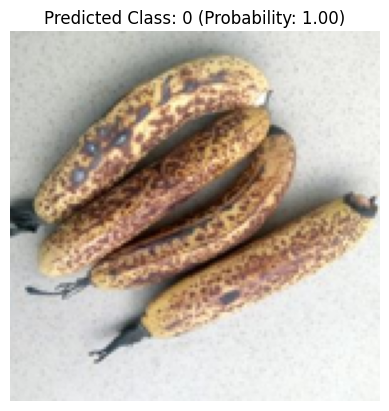

1/1 [==============================] - 0s 18ms/step


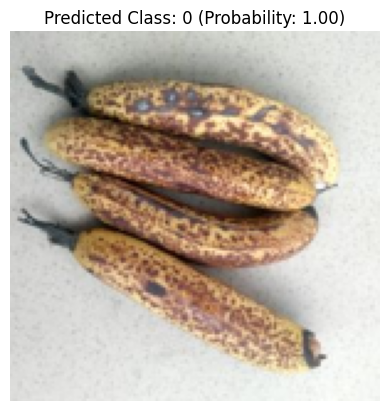

1/1 [==============================] - 0s 15ms/step


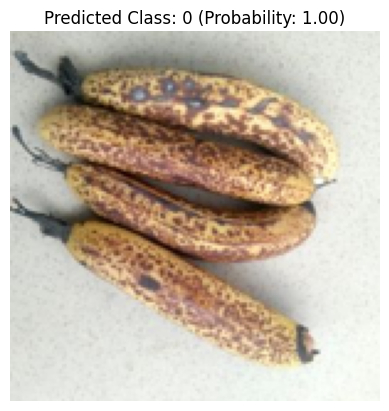

1/1 [==============================] - 0s 28ms/step


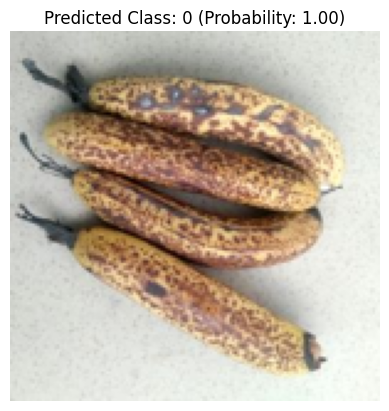

1/1 [==============================] - 0s 14ms/step


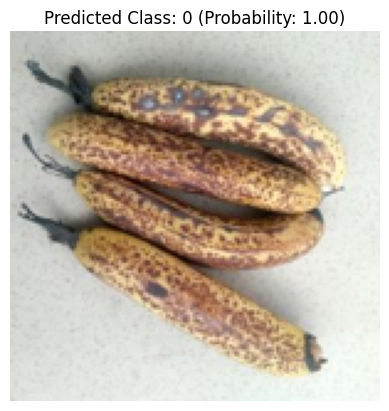

1/1 [==============================] - 0s 14ms/step


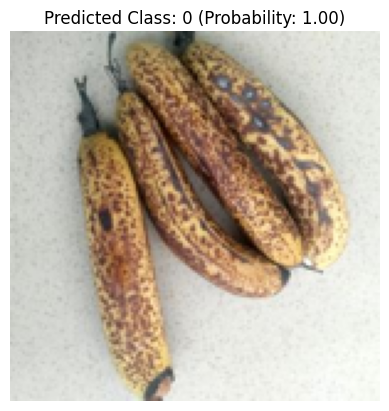

1/1 [==============================] - 0s 18ms/step


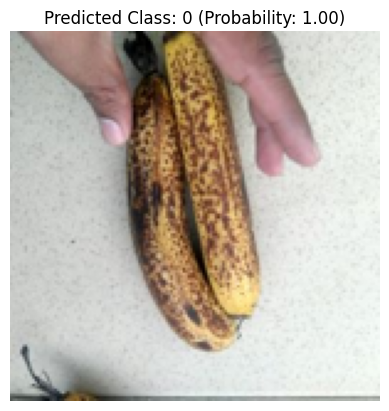

1/1 [==============================] - 0s 15ms/step


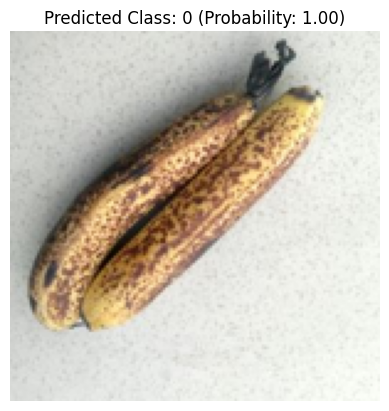

1/1 [==============================] - 0s 13ms/step


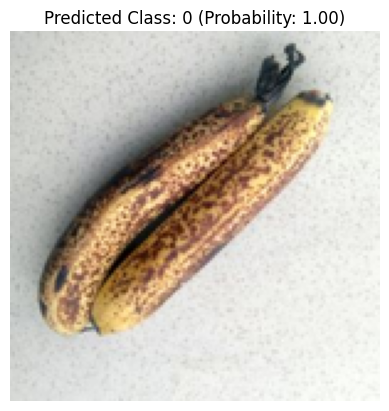

1/1 [==============================] - 0s 14ms/step


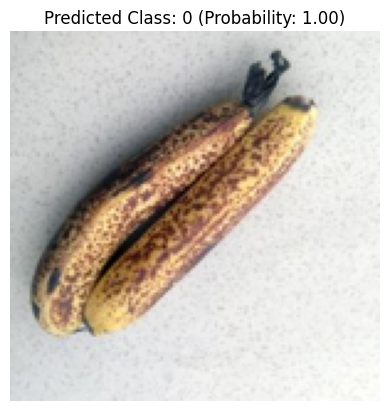

1/1 [==============================] - 0s 13ms/step


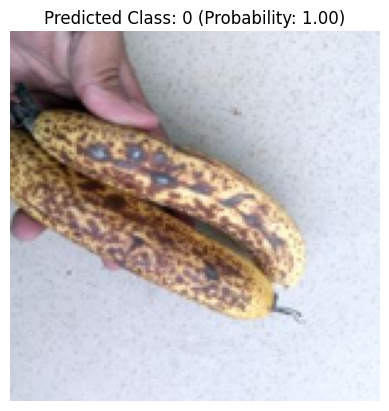

1/1 [==============================] - 0s 14ms/step


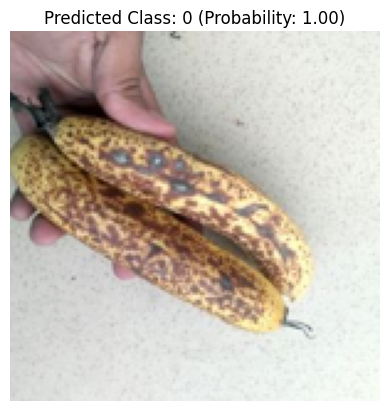

1/1 [==============================] - 0s 13ms/step


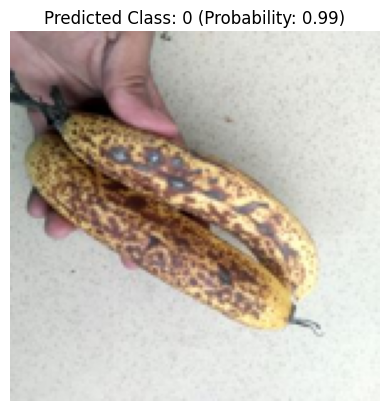

1/1 [==============================] - 0s 15ms/step


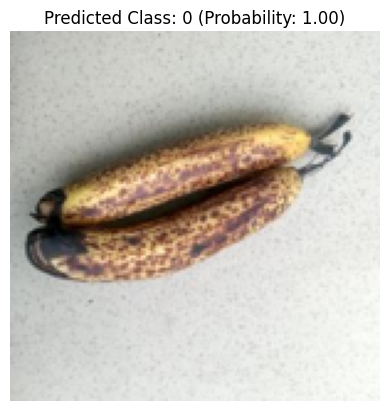

1/1 [==============================] - 0s 14ms/step


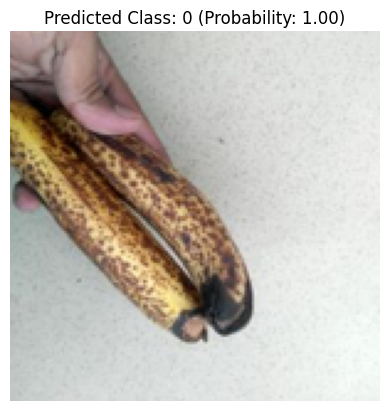

1/1 [==============================] - 0s 13ms/step


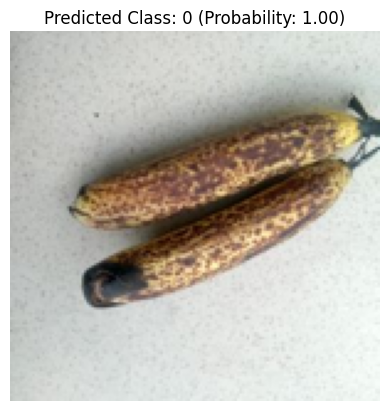

1/1 [==============================] - 0s 14ms/step


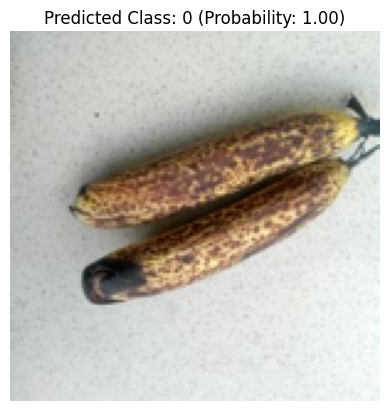

1/1 [==============================] - 0s 14ms/step


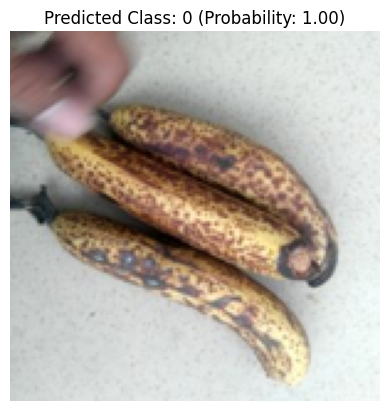

1/1 [==============================] - 0s 14ms/step


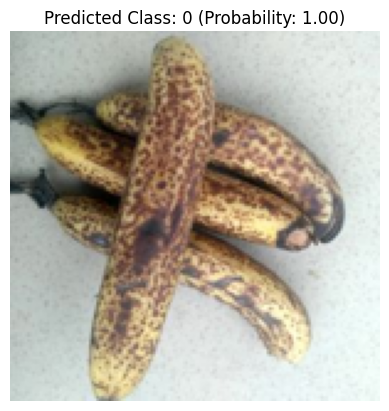

1/1 [==============================] - 0s 17ms/step


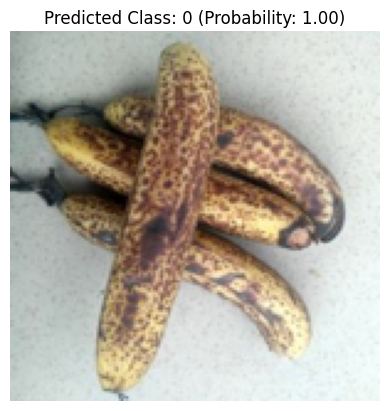

1/1 [==============================] - 0s 14ms/step


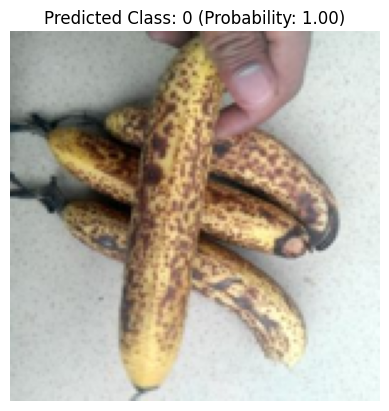

1/1 [==============================] - 0s 15ms/step


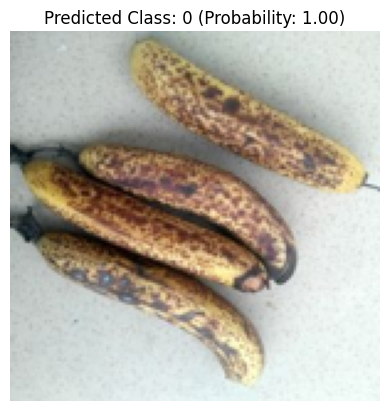

1/1 [==============================] - 0s 15ms/step


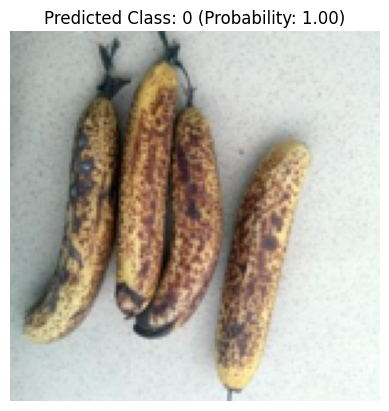

1/1 [==============================] - 0s 14ms/step


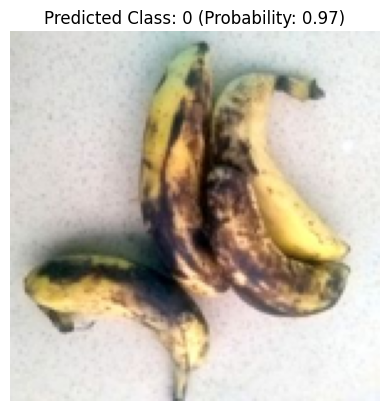

1/1 [==============================] - 0s 19ms/step


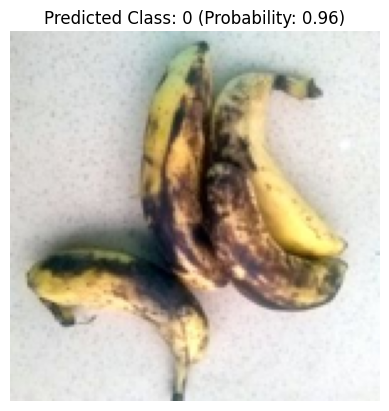

1/1 [==============================] - 0s 13ms/step


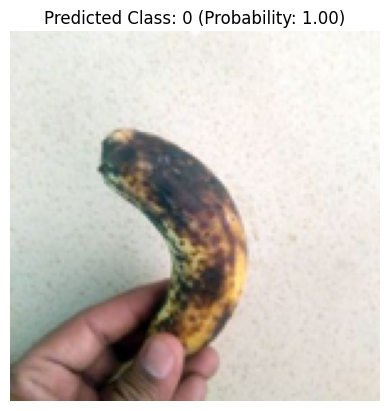

1/1 [==============================] - 0s 14ms/step


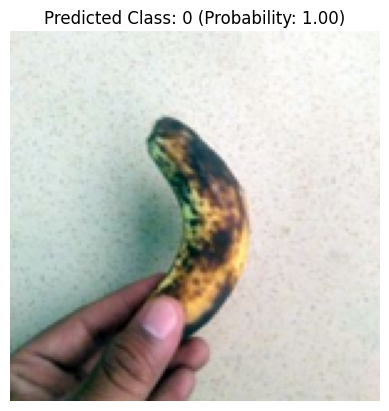

1/1 [==============================] - 0s 14ms/step


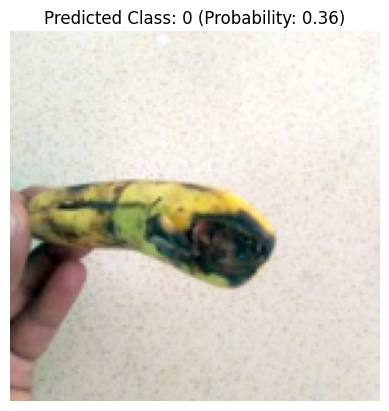

1/1 [==============================] - 0s 13ms/step


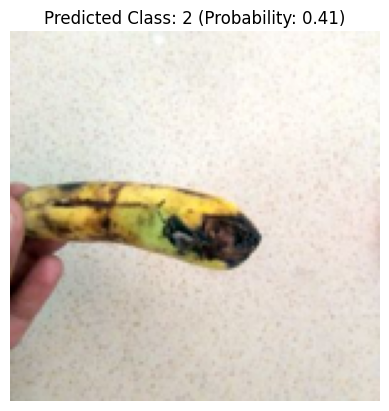

1/1 [==============================] - 0s 15ms/step


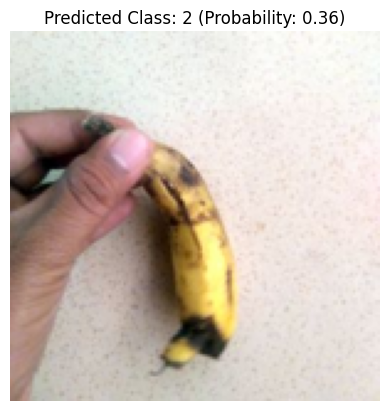

1/1 [==============================] - 0s 13ms/step


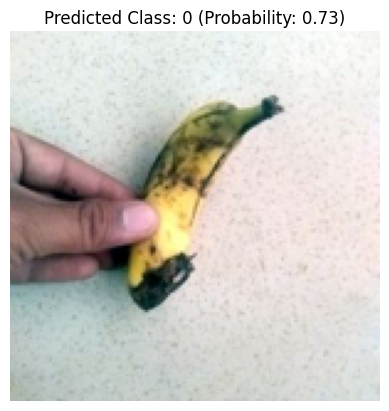

1/1 [==============================] - 0s 14ms/step


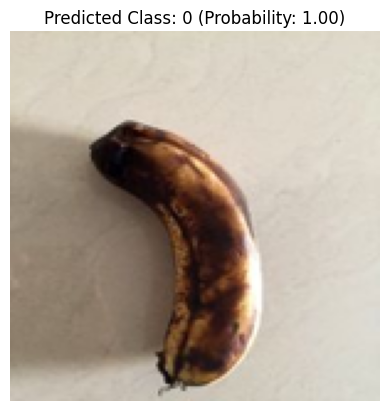

1/1 [==============================] - 0s 13ms/step


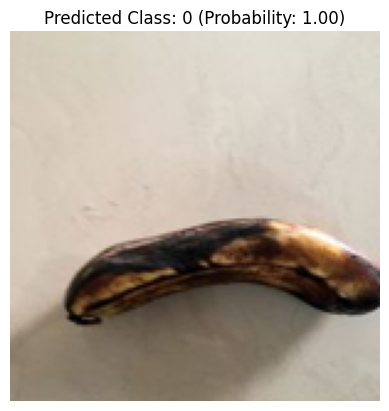

1/1 [==============================] - 0s 13ms/step


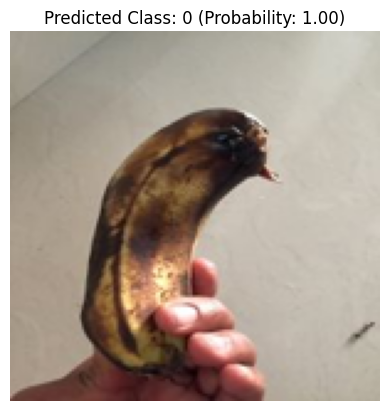

1/1 [==============================] - 0s 13ms/step


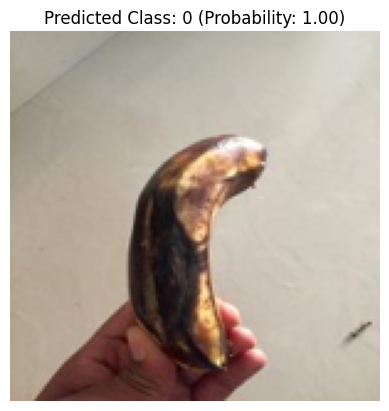

1/1 [==============================] - 0s 14ms/step


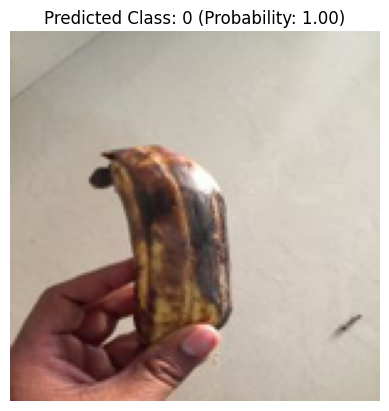

1/1 [==============================] - 0s 13ms/step


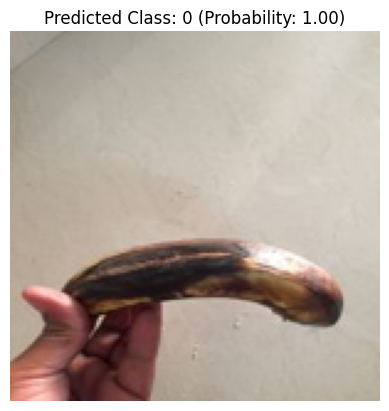

1/1 [==============================] - 0s 13ms/step


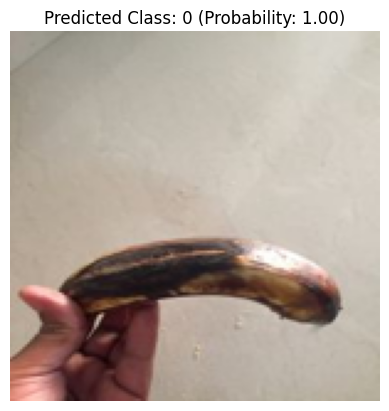

1/1 [==============================] - 0s 13ms/step


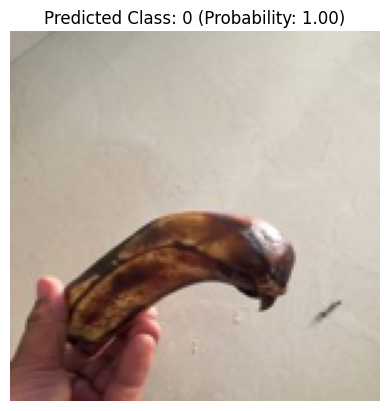

1/1 [==============================] - 0s 14ms/step


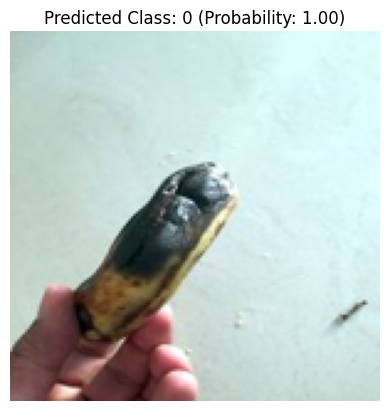

1/1 [==============================] - 0s 14ms/step


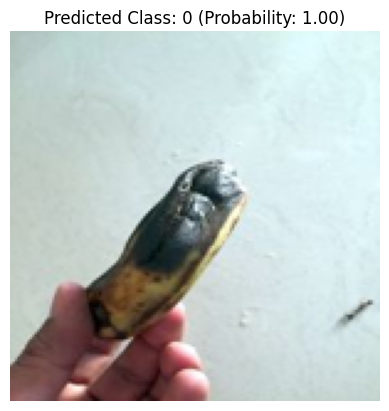

1/1 [==============================] - 0s 15ms/step


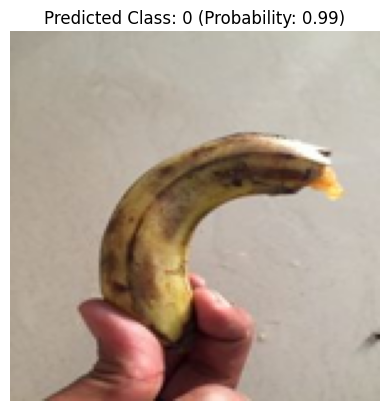

1/1 [==============================] - 0s 35ms/step


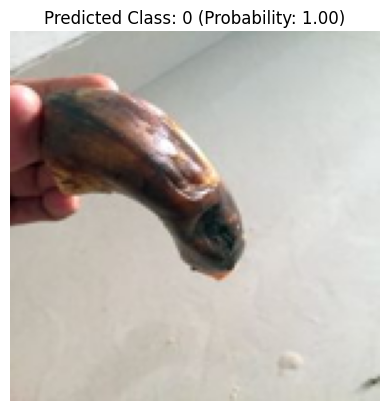

1/1 [==============================] - 0s 14ms/step


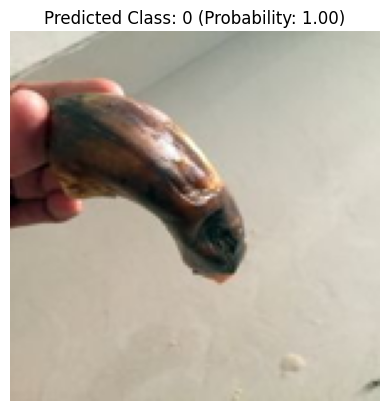

1/1 [==============================] - 0s 16ms/step


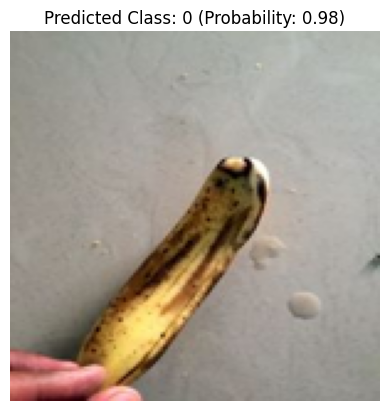

1/1 [==============================] - 0s 15ms/step


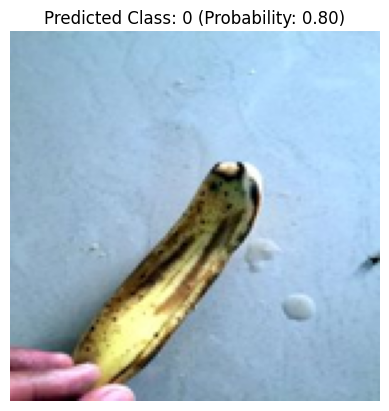

1/1 [==============================] - 0s 13ms/step


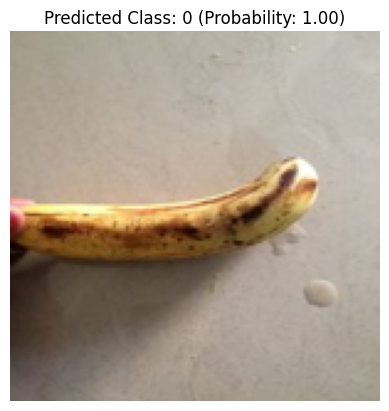

1/1 [==============================] - 0s 16ms/step


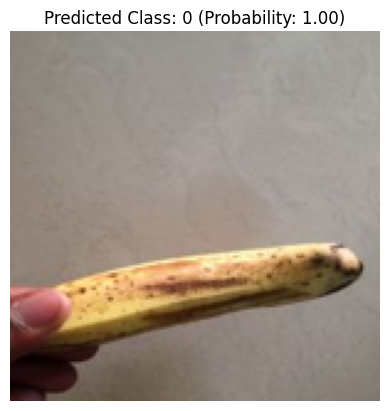

1/1 [==============================] - 0s 16ms/step


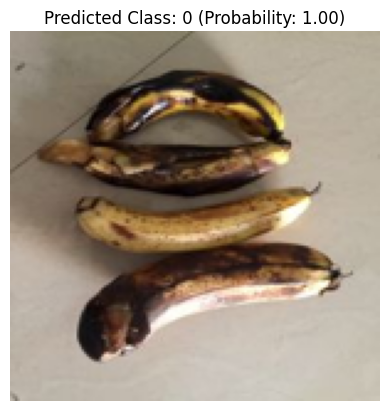

1/1 [==============================] - 0s 14ms/step


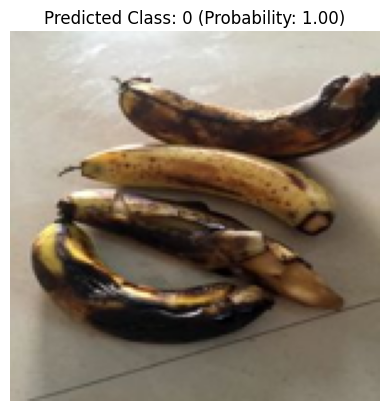

1/1 [==============================] - 0s 14ms/step


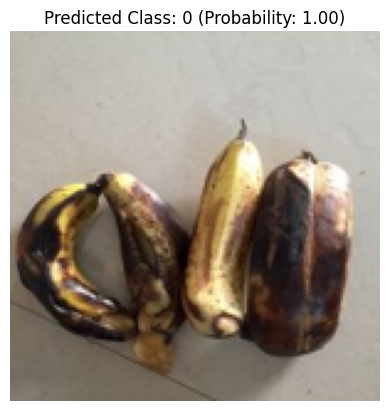

1/1 [==============================] - 0s 13ms/step


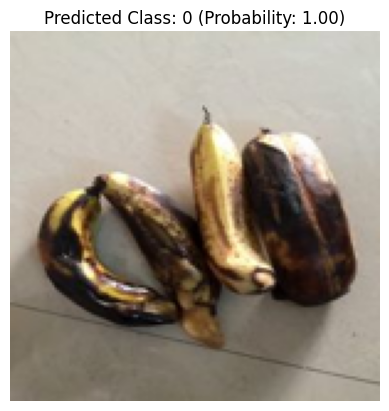

1/1 [==============================] - 0s 14ms/step


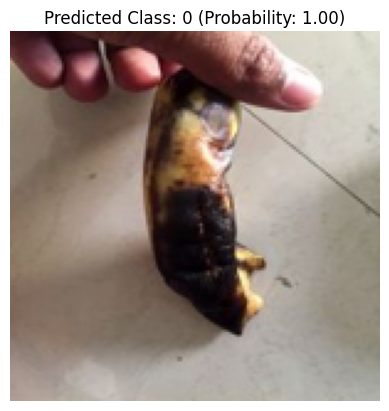

1/1 [==============================] - 0s 14ms/step


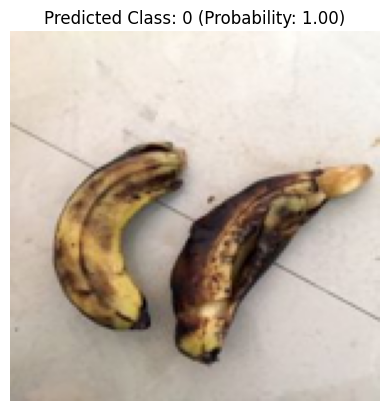

1/1 [==============================] - 0s 19ms/step


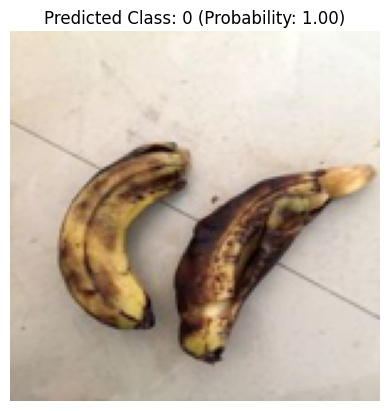

1/1 [==============================] - 0s 15ms/step


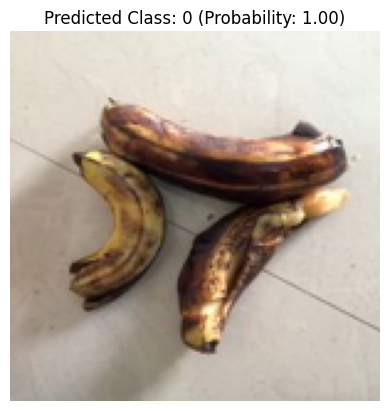

1/1 [==============================] - 0s 14ms/step


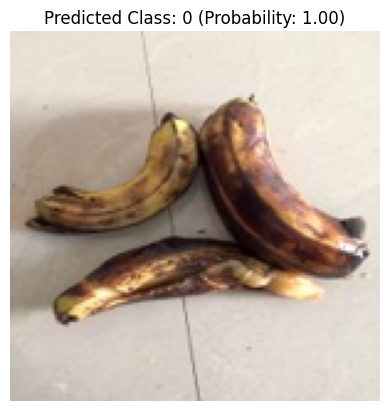

1/1 [==============================] - 0s 13ms/step


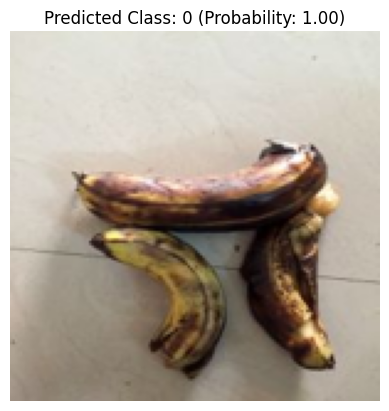

1/1 [==============================] - 0s 13ms/step


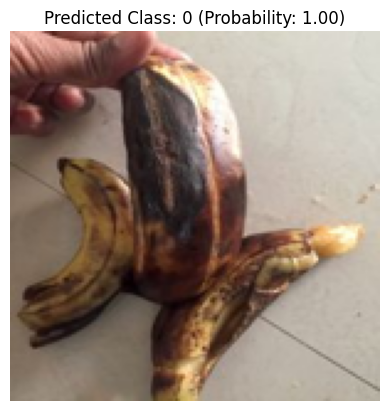

In [63]:
import os
import numpy as np
import matplotlib.pyplot as plt
from PIL import Image

# Path ke folder yang berisi gambar untuk kelas tertentu
folder_path = "validation/Banana_Bad"  # Ganti dengan path folder Anda


# Mendapatkan daftar semua file dalam folder
files = os.listdir(folder_path)

# Memfilter hanya file gambar dengan ekstensi tertentu (misalnya: jpg, png)
image_files = [file for file in files if file.endswith(('.JPG','.jpg', '.jpeg', '.png'))]

# Prediksi kelas untuk setiap gambar
for image_file in image_files:
    # Memuat gambar
    image_path = os.path.join(folder_path, image_file)
    img = Image.open(image_path)
    img = img.resize((150, 150))  # Sesuaikan dengan ukuran input model Anda
    
    # Preprocessing gambar (misalnya: normalisasi, konversi ke array numpy)
    img_array = np.array(img) / 255.0  # Normalisasi pixel intensities
    
    # Menambahkan dimensi batch karena model membutuhkan input dalam bentuk batch
    img_array = np.expand_dims(img_array, axis=0)
    
    # Melakukan prediksi menggunakan model
    prediction = model.predict(img_array)
    
    # Mendapatkan kelas prediksi (misalnya: indeks kelas dengan probabilitas tertinggi)
    predicted_class_index = np.argmax(prediction)
    
    # Menampilkan gambar dan hasil prediksi
    plt.imshow(img)
    plt.title(f"Predicted Class: {predicted_class_index} (Probability: {prediction[0][predicted_class_index]:.2f})")
    plt.axis('off')
    plt.show()

In [64]:
model.save('model_final.h5')

In [66]:
from tensorflow.keras.models import load_model
model = load_model('model_final.h5')